In [129]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [248]:
df = pd.read_csv('/Users/franckatteaka/Desktop/cours/Semester III/ML_for_finance/Data/data_clean.csv',sep = ",",parse_dates = True,index_col = 0 )

In [249]:
df.iloc[:,0:4] = df.iloc[:,0:4].apply(lambda x: x/(10 * x.max())).copy()
df.iloc[:,4:] = df.iloc[:,4:].copy()/100

In [250]:
df.head()

,sentiment eu,sentiment ch,kofbarometer,kof mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
Date,,,,,,,,,,,,,,,,,
2007-04-02,0.097908,0.099382,0.077428,0.025668,0.02412,0.02402,0.02414,0.02462,0.02521,0.02574,0.02619,0.02656,0.02686,0.02710,0.02784,0.02821,0.02858
2007-04-03,0.097908,0.099382,0.077428,0.025668,0.02414,0.02420,0.02441,0.02490,0.02546,0.02595,0.02636,0.02670,0.02697,0.02718,0.02784,0.02818,0.02851
2007-04-04,0.097908,0.099382,0.077428,0.025668,0.02431,0.02430,0.02448,0.02498,0.02553,0.02603,0.02644,0.02677,0.02704,0.02725,0.02791,0.02824,0.02856
2007-04-05,0.097908,0.099382,0.077428,0.025668,0.02439,0.02425,0.02449,0.02506,0.02568,0.02621,0.02663,0.02697,0.02724,0.02746,0.02812,0.02845,0.02878
2007-04-10,0.097908,0.099382,0.077428,0.025668,0.02441,0.02444,0.02477,0.02538,0.02600,0.02653,0.02694,0.02727,0.02754,0.02775,0.02839,0.02871,0.02903


In [168]:
def sub_range(df,nb_years):
    last = df.index.date.max()
    first =  last.replace(year = last.year - nb_years)
    terms = ['1J', '2J','3J', '4J', '5J', '6J',
            '7J', '8J', '9J', '10J', '15J', '20J', '30J']
    
    df2 = df[ df.index.date >= first].copy()
    
    return df2
    

    
def yields_plot(df,nb_years,pos = (0,14)):
    last = df.index.date.max()
    first =  last.replace(year = last.year - nb_years)
    terms = ['1J', '2J','3J', '4J', '5J', '6J',
            '7J', '8J', '9J', '10J', '15J', '20J', '30J']
    
    df[ df.index.date >= first].loc[:,terms[pos[0]:pos[1]]].plot(figsize = (15,8)).plot()
    df[ df.index.date >= first].iloc[:,0:4].plot(figsize = (15,8)).plot()
    
    
#def eco_plot(nb_years,)
    

In [119]:
a = [1,2,3]
a.append([1,2])

In [120]:
a

[1, 2, 3, [1, 2]]

In [124]:
n = 5

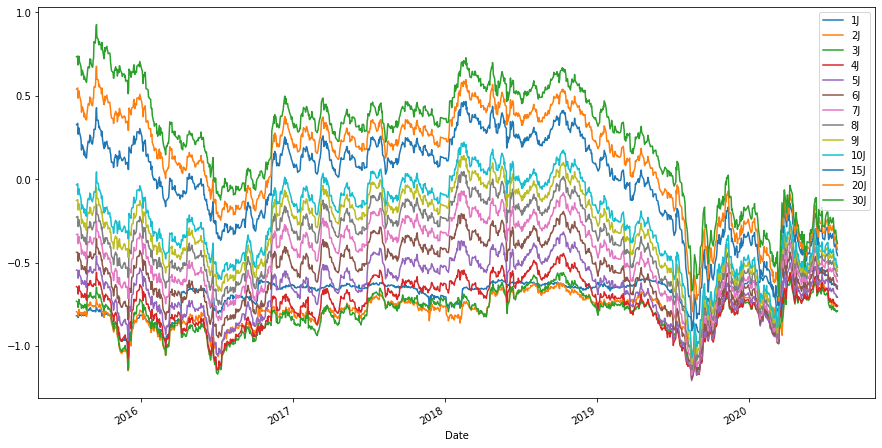

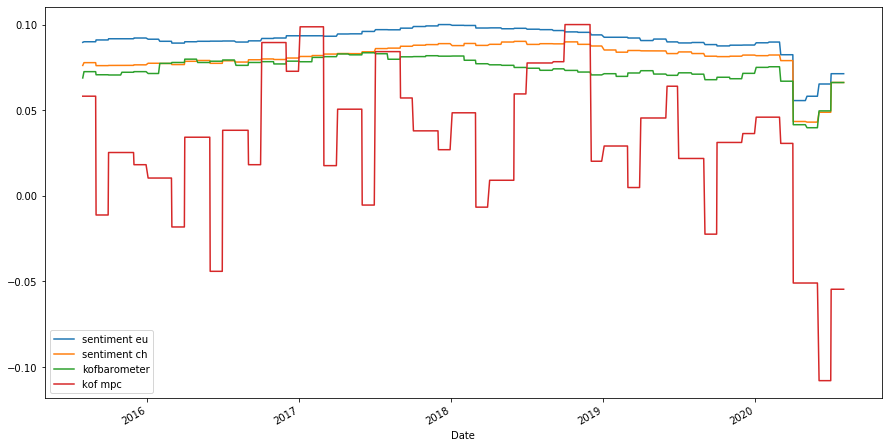

In [170]:
yields_plot(df,nb_years = n)

<Figure size 864x720 with 0 Axes>

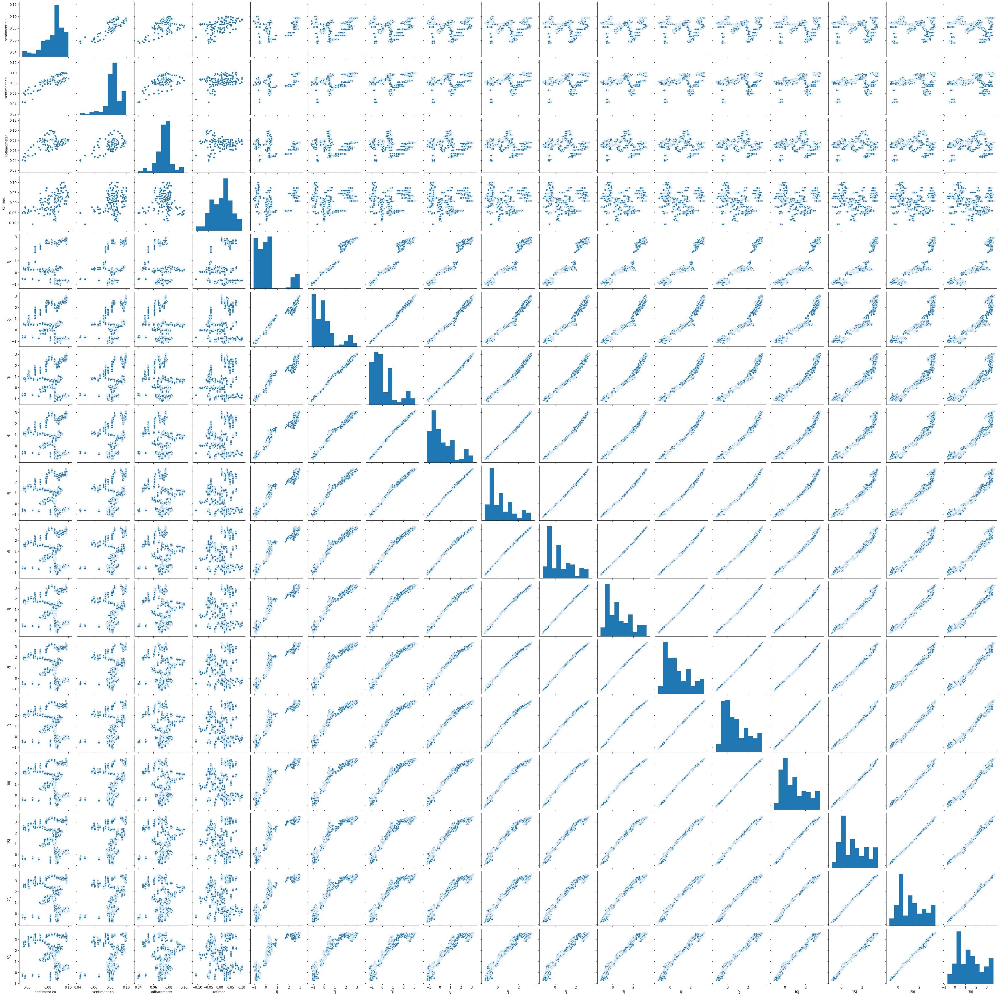

In [139]:
plt.figure(figsize = (12,10))
sns.pairplot(df)

In [237]:
def rolling_diff(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: x.iloc[-1] - x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   
def rolling_vol(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).std().copy()).dropna()
    return df2.join(df.iloc[:,4:])   
    
def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   


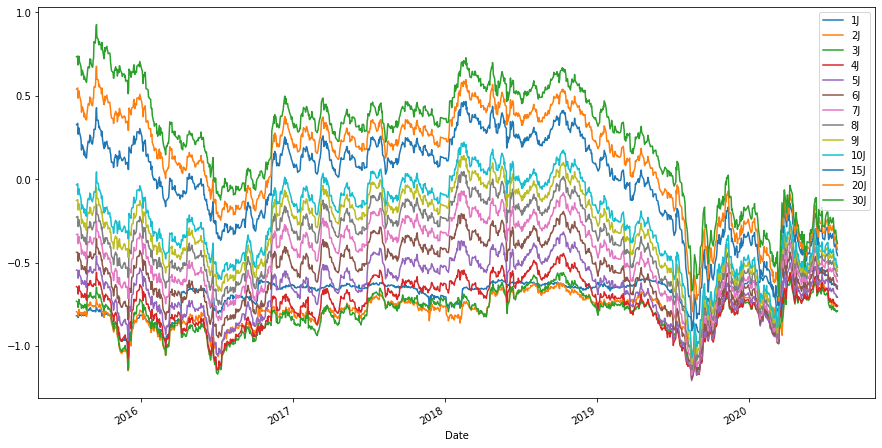

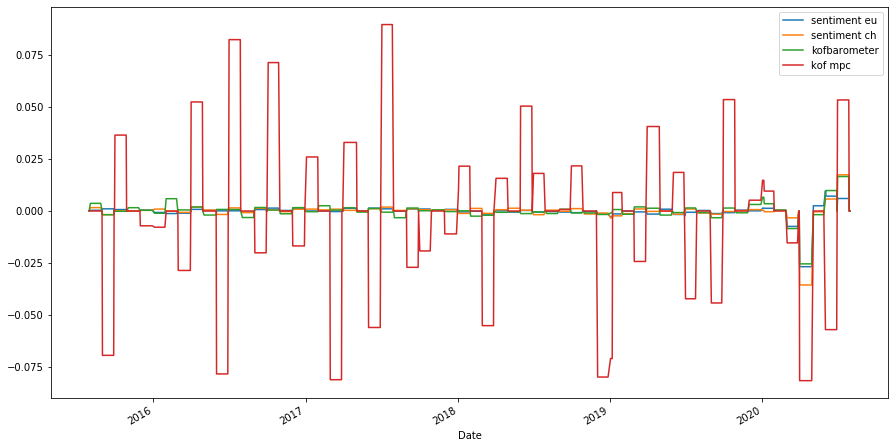

In [197]:
yields_plot(rolling_diff(df,21),nb_years = n)

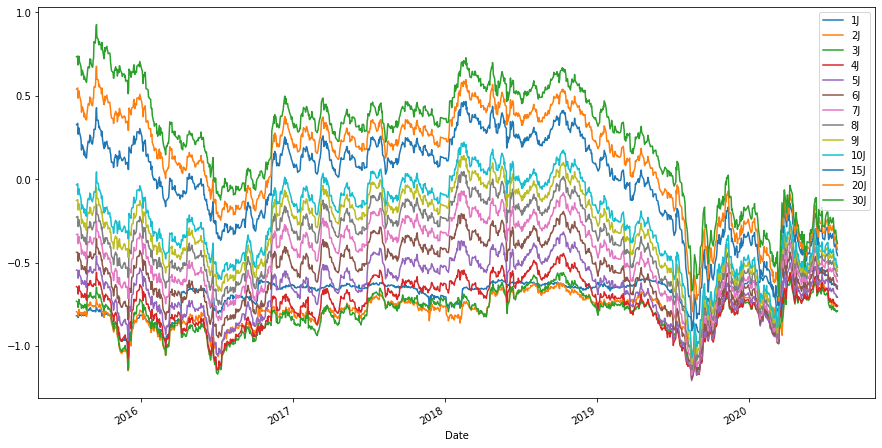

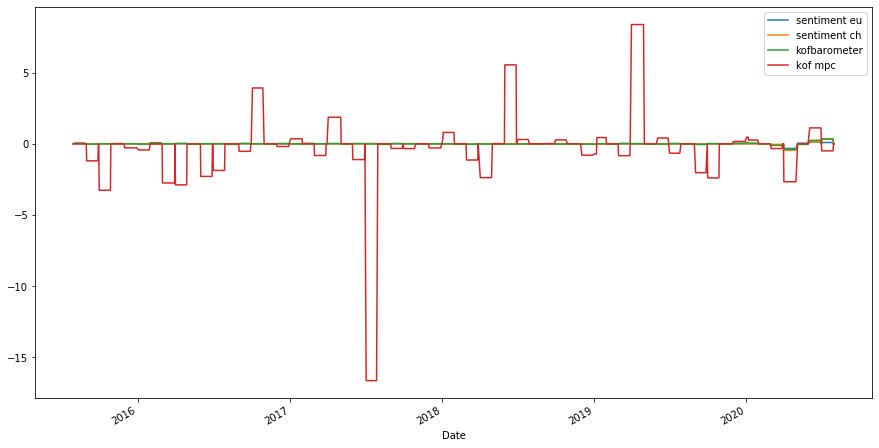

In [238]:
yields_plot(rolling_growth(df,21),nb_years = n)

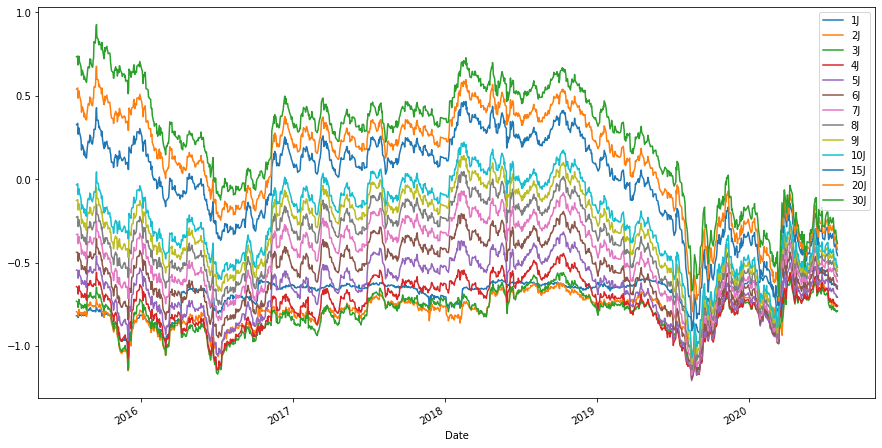

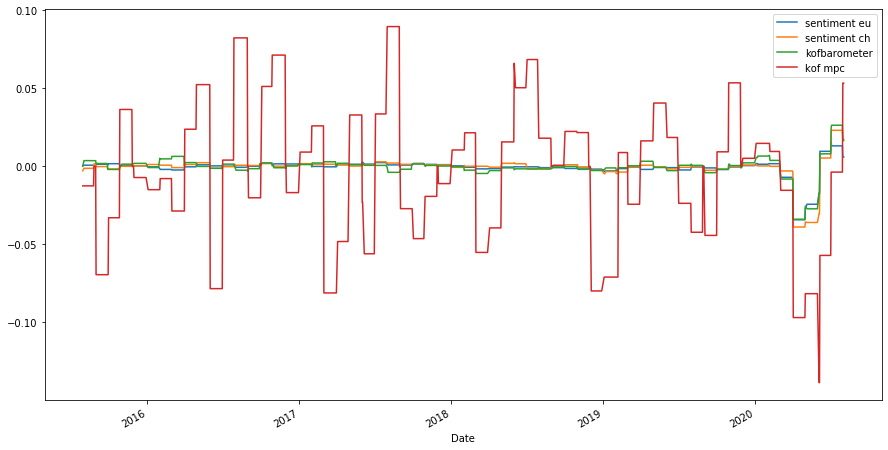

In [198]:
yields_plot(rolling_diff(df,42),nb_years = n)

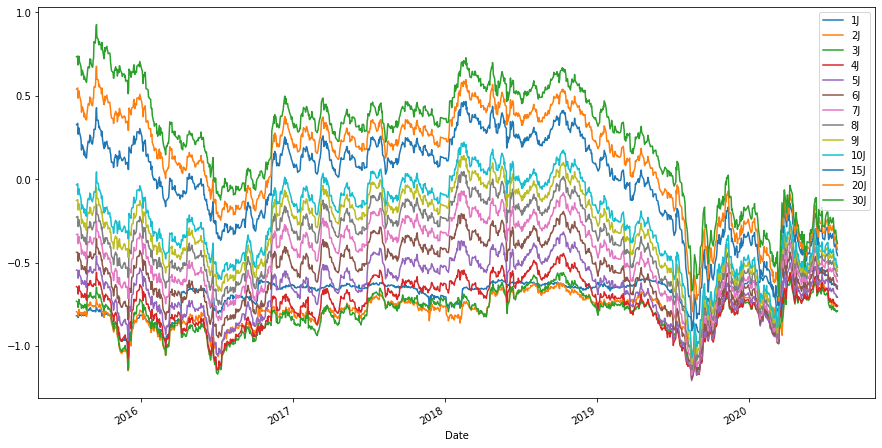

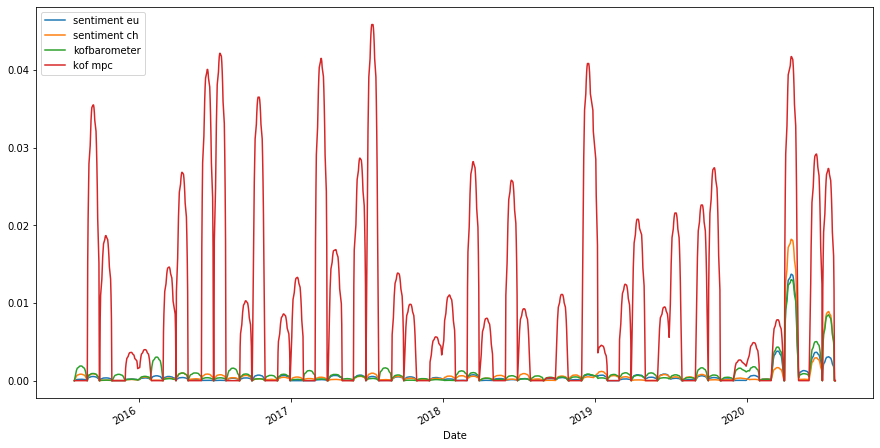

In [204]:
yields_plot(rolling_vol(df,21),nb_years = n)

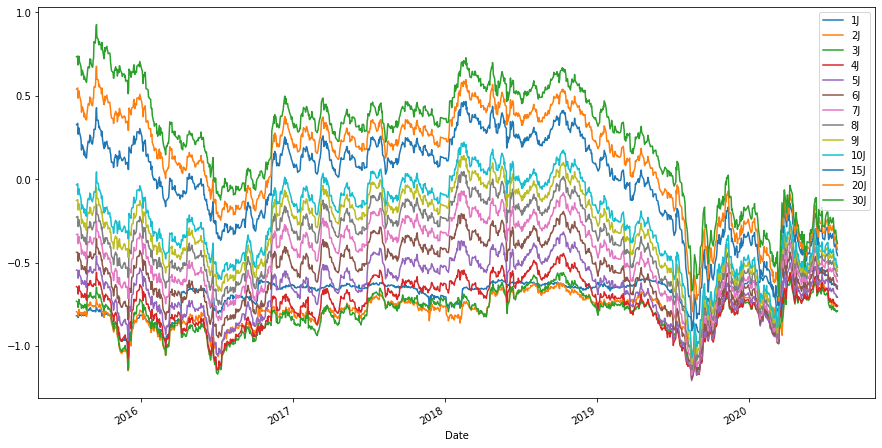

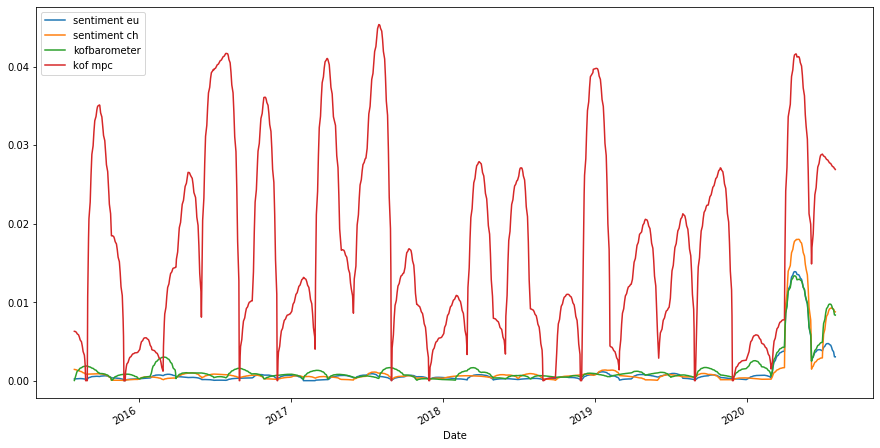

In [205]:
yields_plot(rolling_vol(df,42),nb_years = n)

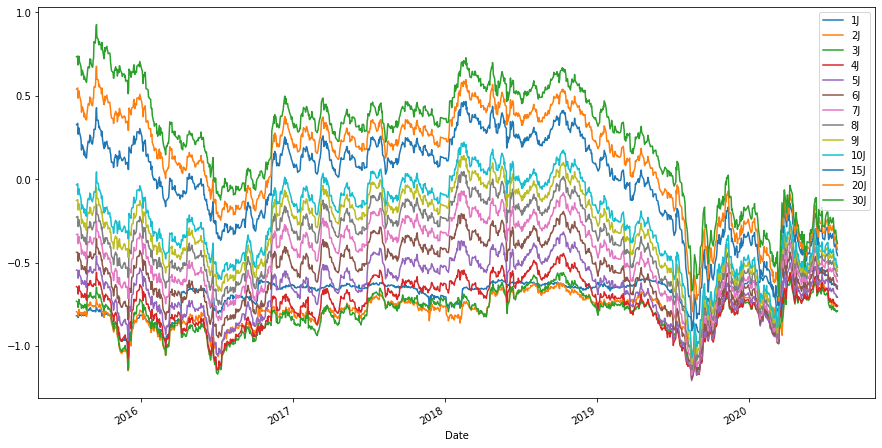

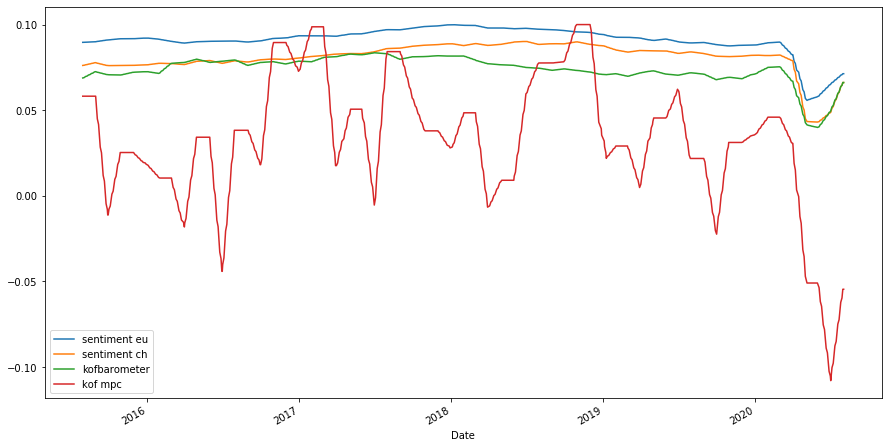

In [208]:
yields_plot(rolling_mean(df,21),nb_years = n)

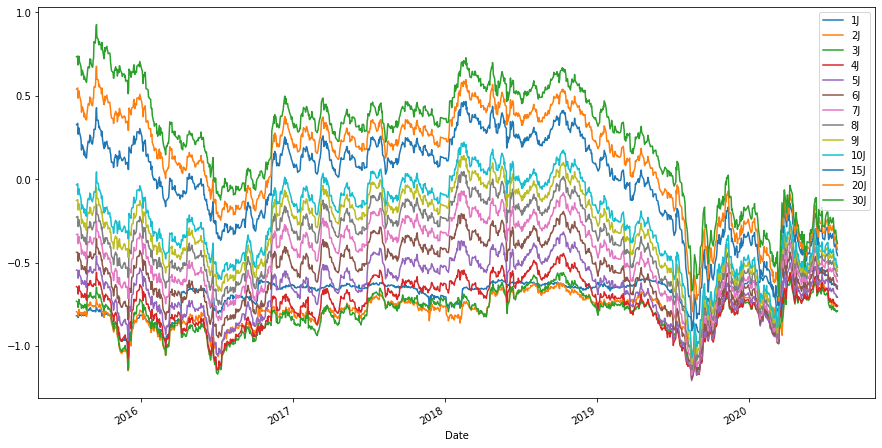

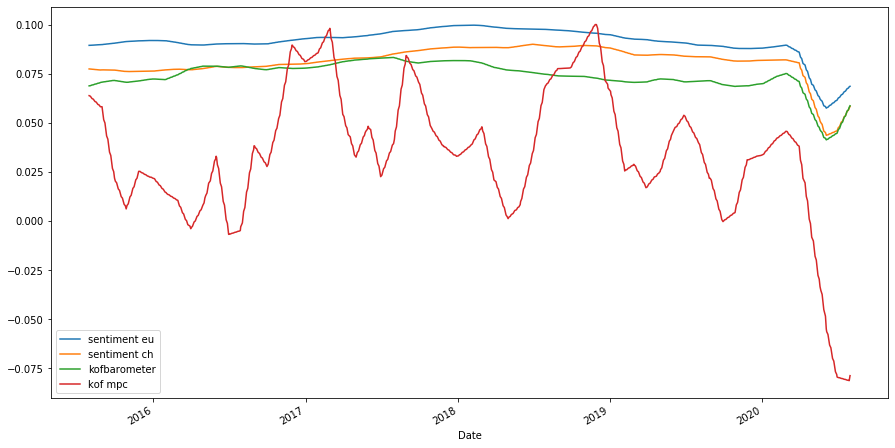

In [210]:
yields_plot(rolling_mean(df,42),nb_years = n)

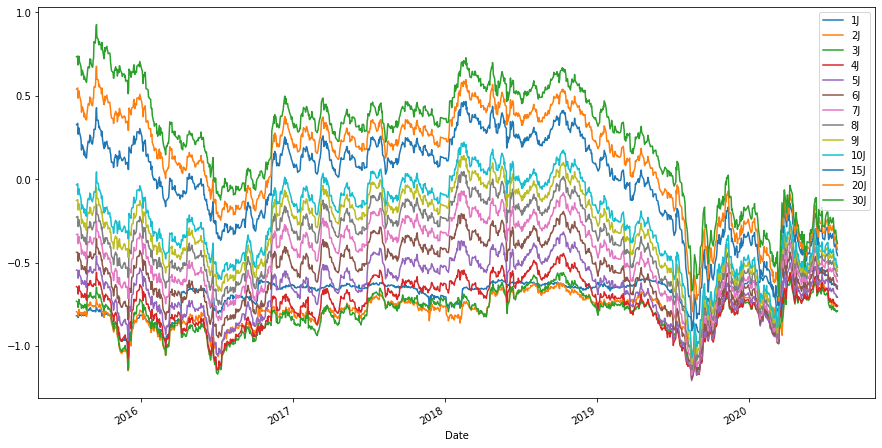

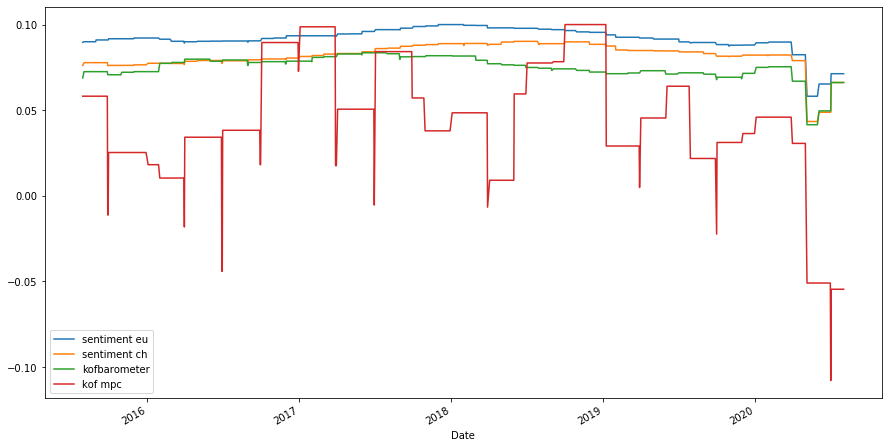

In [213]:
yields_plot(rolling_max(df,21),nb_years = n)

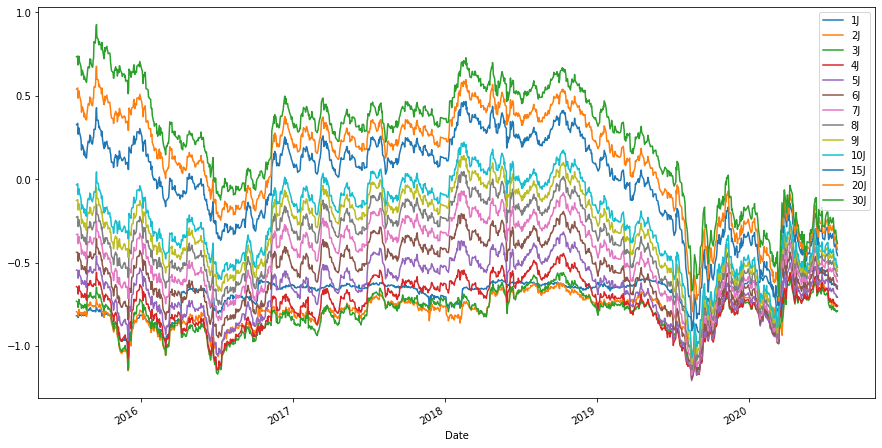

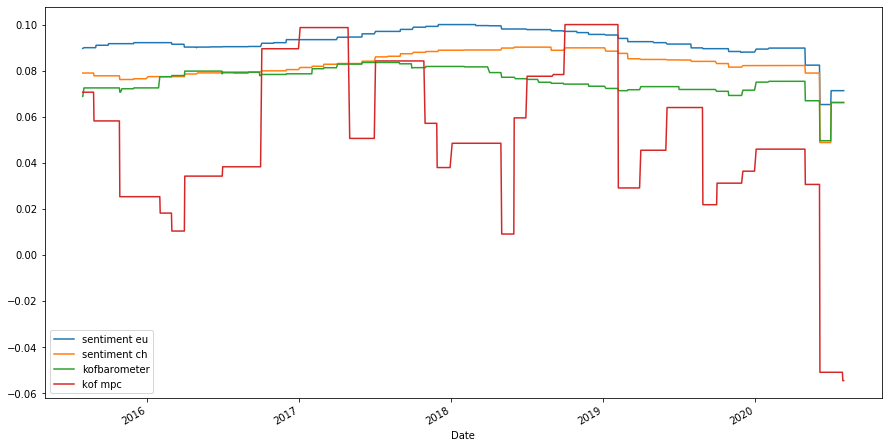

In [214]:
yields_plot(rolling_max(df,42),nb_years = n)

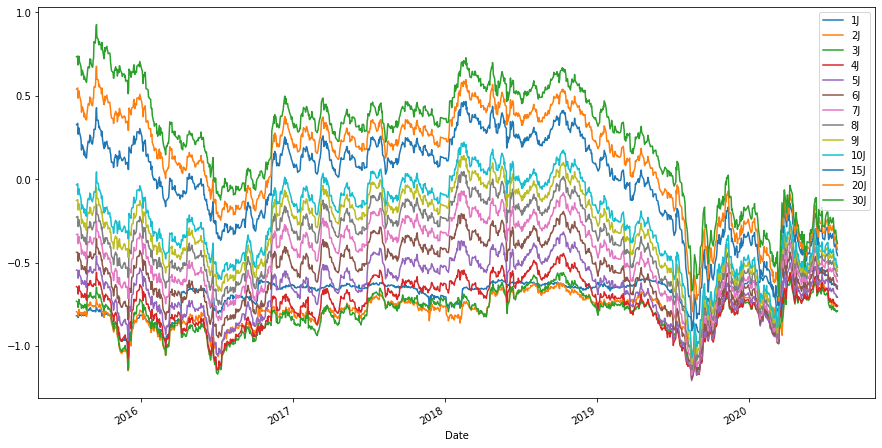

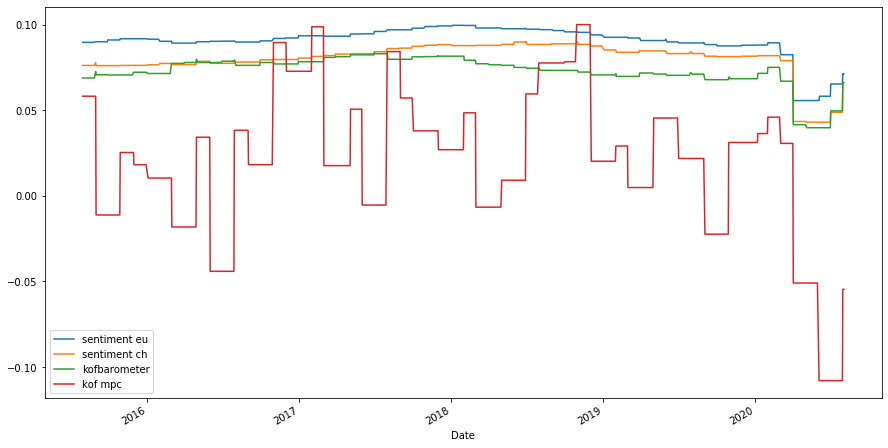

In [215]:
yields_plot(rolling_min(df,21),nb_years = n)

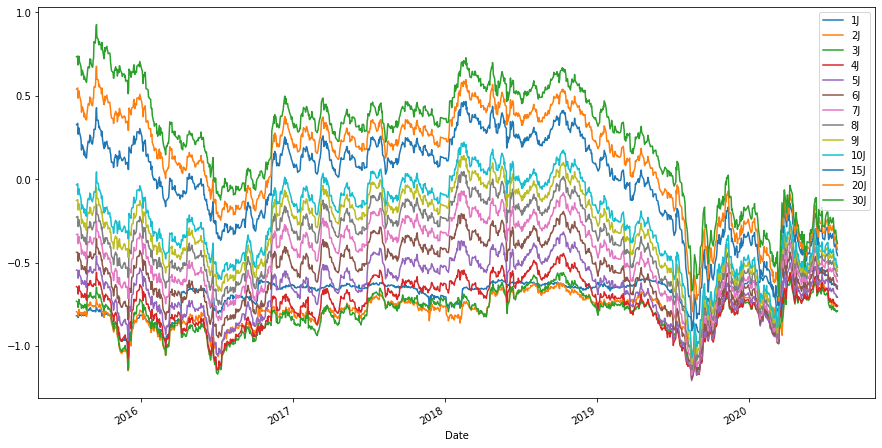

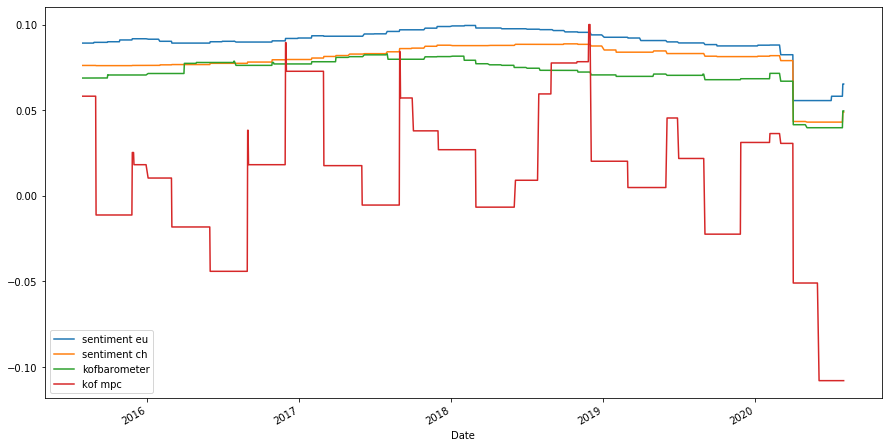

In [216]:
yields_plot(rolling_min(df,42),nb_years = n)

In [223]:
df2 = sub_range(df,n)

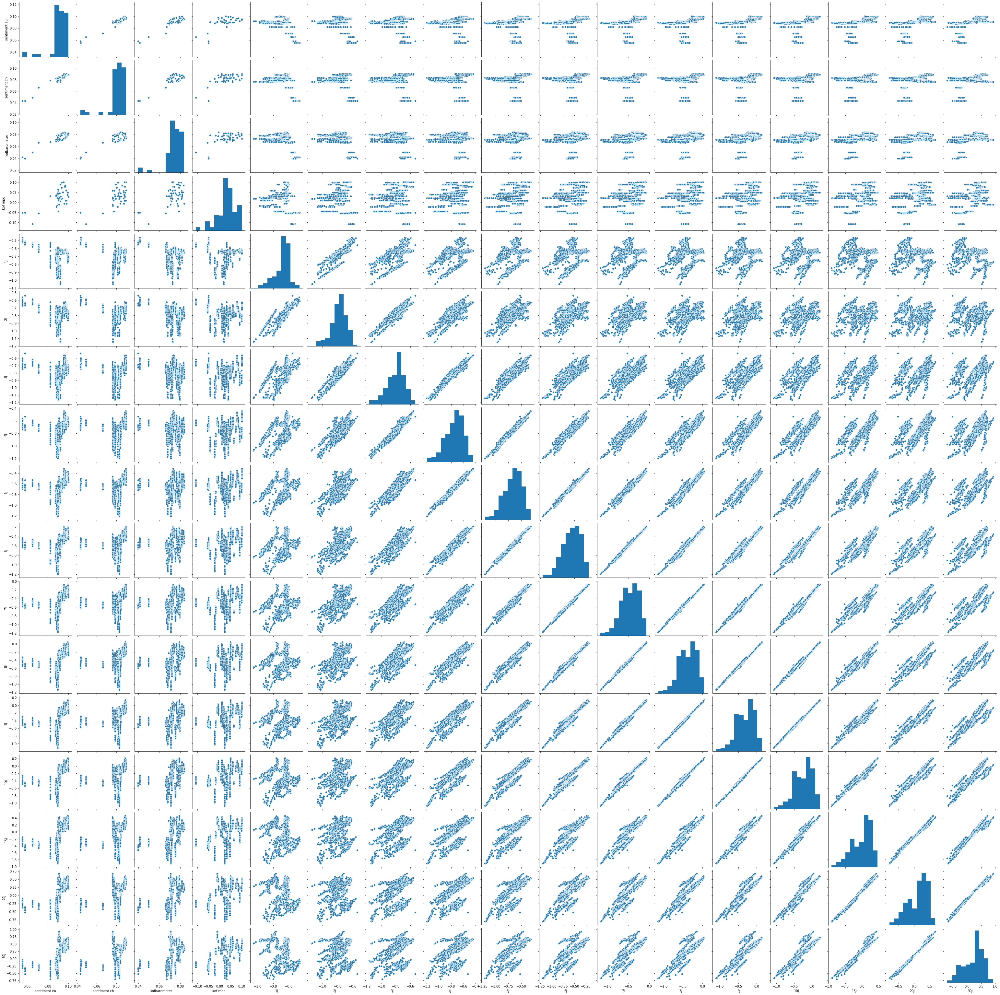

In [234]:
sns.pairplot(df2)

<Figure size 864x720 with 0 Axes>

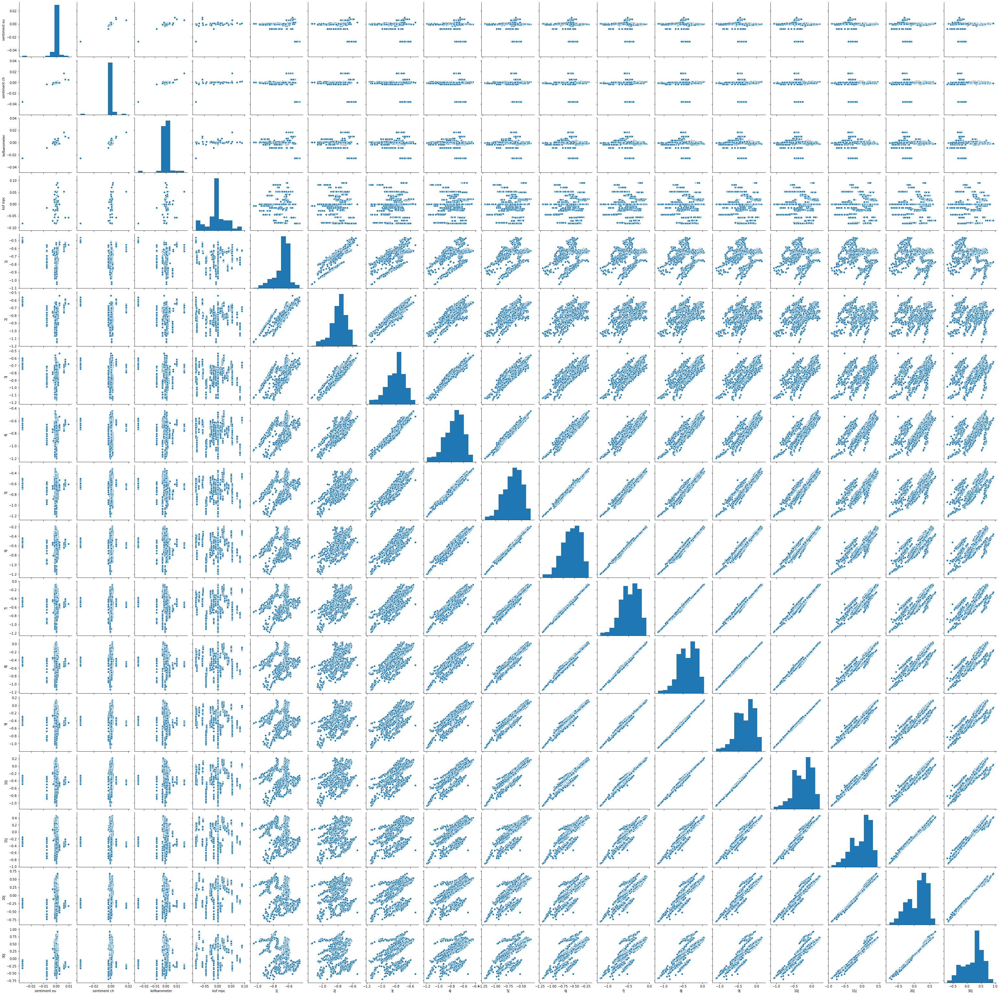

In [231]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_diff(df2,21))

<Figure size 864x720 with 0 Axes>

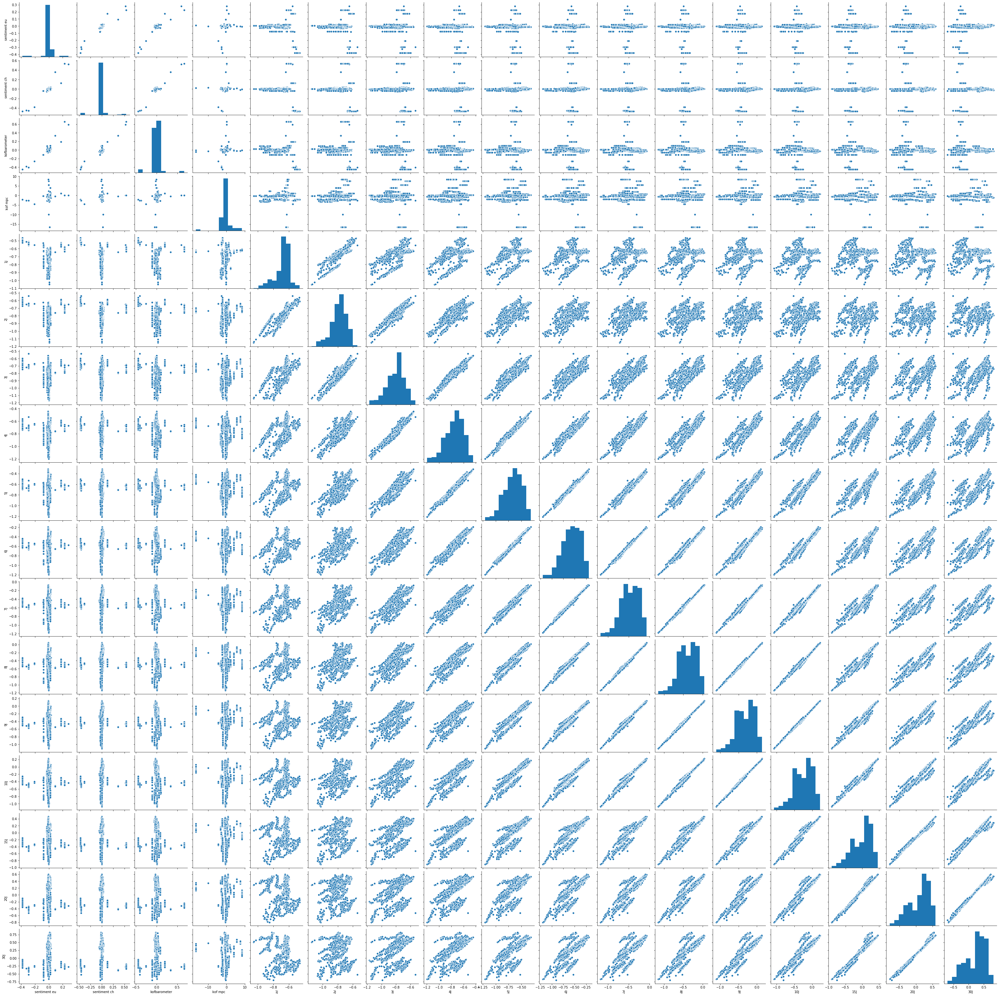

In [240]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_growth(df2,42))

In [236]:
df2.corr()

,sentiment eu,sentiment ch,kofbarometer,kof mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
sentiment eu,1.000000,0.944553,0.878263,0.640339,-0.232184,-0.149613,0.024185,0.168907,0.273290,0.348093,0.404057,0.447470,0.481888,0.509308,0.579718,0.598454,0.608616
sentiment ch,0.944553,1.000000,0.799397,0.654037,-0.114449,-0.052116,0.060424,0.156002,0.227886,0.281256,0.321984,0.353465,0.377922,0.396641,0.437018,0.441542,0.443224
kofbarometer,0.878263,0.799397,1.000000,0.552579,-0.241106,-0.318748,-0.193355,-0.034244,0.093338,0.184760,0.249502,0.296031,0.330093,0.355284,0.410180,0.419461,0.420490
kof mpc,0.640339,0.654037,0.552579,1.000000,0.069941,0.082547,0.128365,0.187287,0.238256,0.277012,0.305883,0.327023,0.342424,0.353247,0.368305,0.362192,0.355570
1J,-0.232184,-0.114449,-0.241106,0.069941,1.000000,0.822244,0.587799,0.479936,0.426903,0.387302,0.348653,0.308249,0.266521,0.224430,0.042811,-0.064990,-0.148714
2J,-0.149613,-0.052116,-0.318748,0.082547,0.822244,1.000000,0.918999,0.806977,0.711937,0.635761,0.574431,0.523354,0.479484,0.440668,0.298064,0.218107,0.152199
3J,0.024185,0.060424,-0.193355,0.128365,0.587799,0.918999,1.000000,0.964647,0.898835,0.833866,0.778765,0.733406,0.695759,0.663644,0.550621,0.485342,0.426264
4J,0.168907,0.156002,-0.034244,0.187287,0.479936,0.806977,0.964647,1.000000,0.980979,0.944743,0.907633,0.874160,0.844714,0.818473,0.717444,0.652938,0.591242
5J,0.273290,0.227886,0.093338,0.238256,0.426903,0.711937,0.898835,0.980979,1.000000,0.990111,0.970635,0.949068,0.927733,0.907072,0.815738,0.751062,0.687364
6J,0.348093,0.281256,0.184760,0.277012,0.387302,0.635761,0.833866,0.944743,0.990111,1.000000,0.994634,0.983148,0.969073,0.953706,0.873772,0.811323,0.748345


In [235]:
rolling_diff(df2,21).corr()

,sentiment eu,sentiment ch,kofbarometer,kof mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
sentiment eu,1.000000,0.930752,0.865613,0.280154,-0.113553,-0.088057,-0.047761,-0.016910,0.005715,0.022820,0.035948,0.046332,0.054679,0.061640,0.082855,0.092160,0.099861
sentiment ch,0.930752,1.000000,0.899861,0.348644,-0.136430,-0.111078,-0.061255,-0.023277,0.002192,0.019507,0.031562,0.040271,0.046724,0.051709,0.064303,0.067932,0.069913
kofbarometer,0.865613,0.899861,1.000000,0.282053,-0.127843,-0.101001,-0.076186,-0.064244,-0.056610,-0.049916,-0.043904,-0.038346,-0.033306,-0.028634,-0.011620,-0.003723,0.000506
kof mpc,0.280154,0.348644,0.282053,1.000000,-0.001065,-0.018180,-0.029978,-0.032824,-0.030781,-0.027082,-0.023470,-0.020715,-0.018775,-0.017435,-0.016212,-0.016683,-0.015559
1J,-0.113553,-0.136430,-0.127843,-0.001065,1.000000,0.831264,0.606668,0.498220,0.442248,0.400418,0.360672,0.320097,0.278834,0.237599,0.061363,-0.043403,-0.125810
2J,-0.088057,-0.111078,-0.101001,-0.018180,0.831264,1.000000,0.921521,0.809686,0.713867,0.637211,0.575730,0.524718,0.481048,0.442520,0.301604,0.222543,0.156849
3J,-0.047761,-0.061255,-0.076186,-0.029978,0.606668,0.921521,1.000000,0.964550,0.898592,0.833614,0.778472,0.732965,0.695090,0.662718,0.548743,0.483029,0.423411
4J,-0.016910,-0.023277,-0.064244,-0.032824,0.498220,0.809686,0.964550,1.000000,0.980984,0.944801,0.907674,0.874064,0.844403,0.817928,0.716314,0.651826,0.589975
5J,0.005715,0.002192,-0.056610,-0.030781,0.442248,0.713867,0.898592,0.980984,1.000000,0.990131,0.970653,0.949020,0.927588,0.906847,0.815908,0.752014,0.688753
6J,0.022820,0.019507,-0.049916,-0.027082,0.400418,0.637211,0.833614,0.944801,0.990131,1.000000,0.994631,0.983124,0.969034,0.953696,0.874857,0.813745,0.751645


<Figure size 864x720 with 0 Axes>

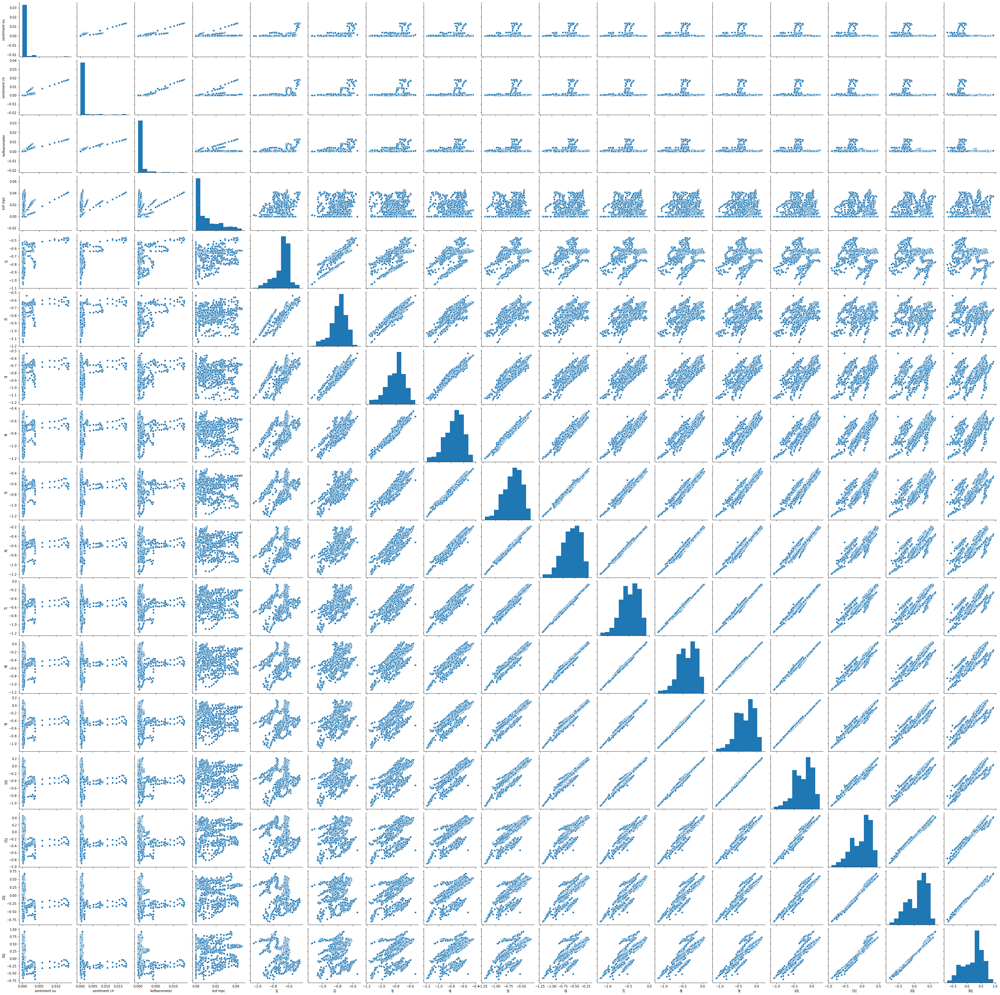

In [226]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_vol(df2,21))

<Figure size 864x720 with 0 Axes>

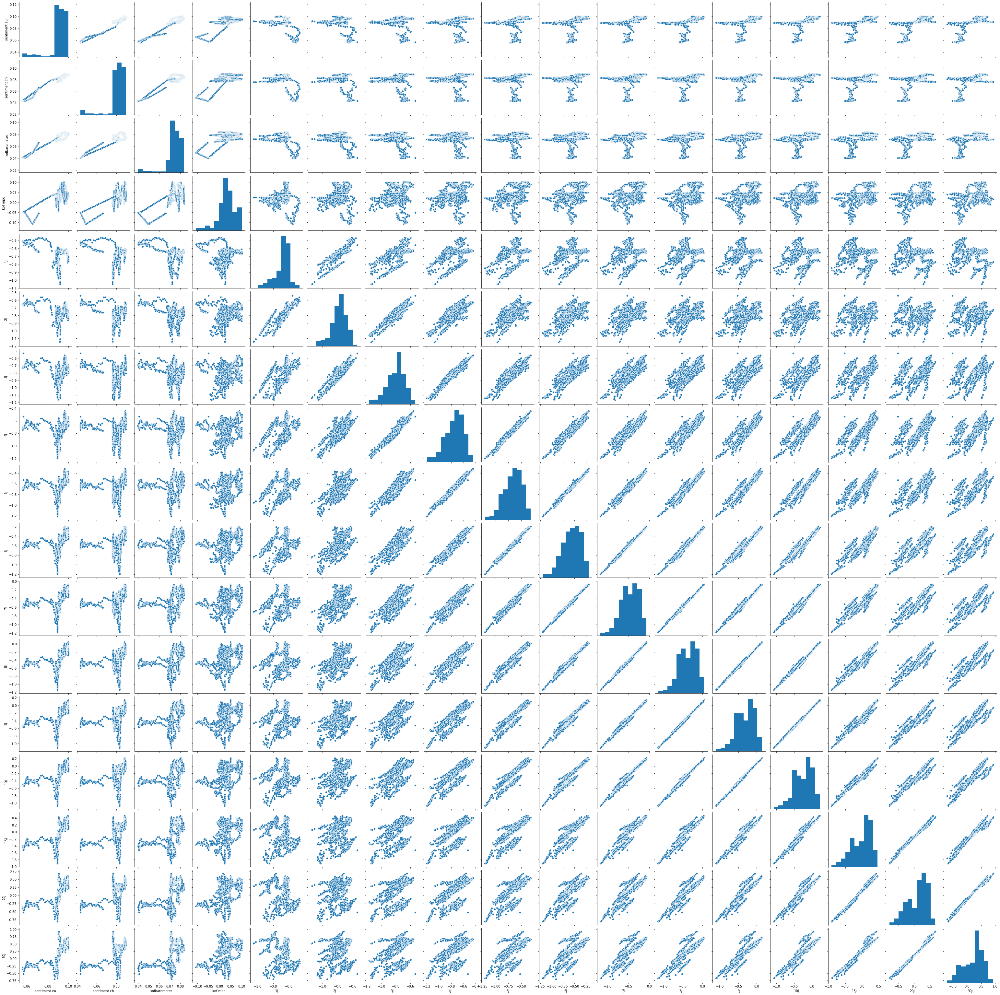

In [227]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_mean(df2,21))

<Figure size 864x720 with 0 Axes>

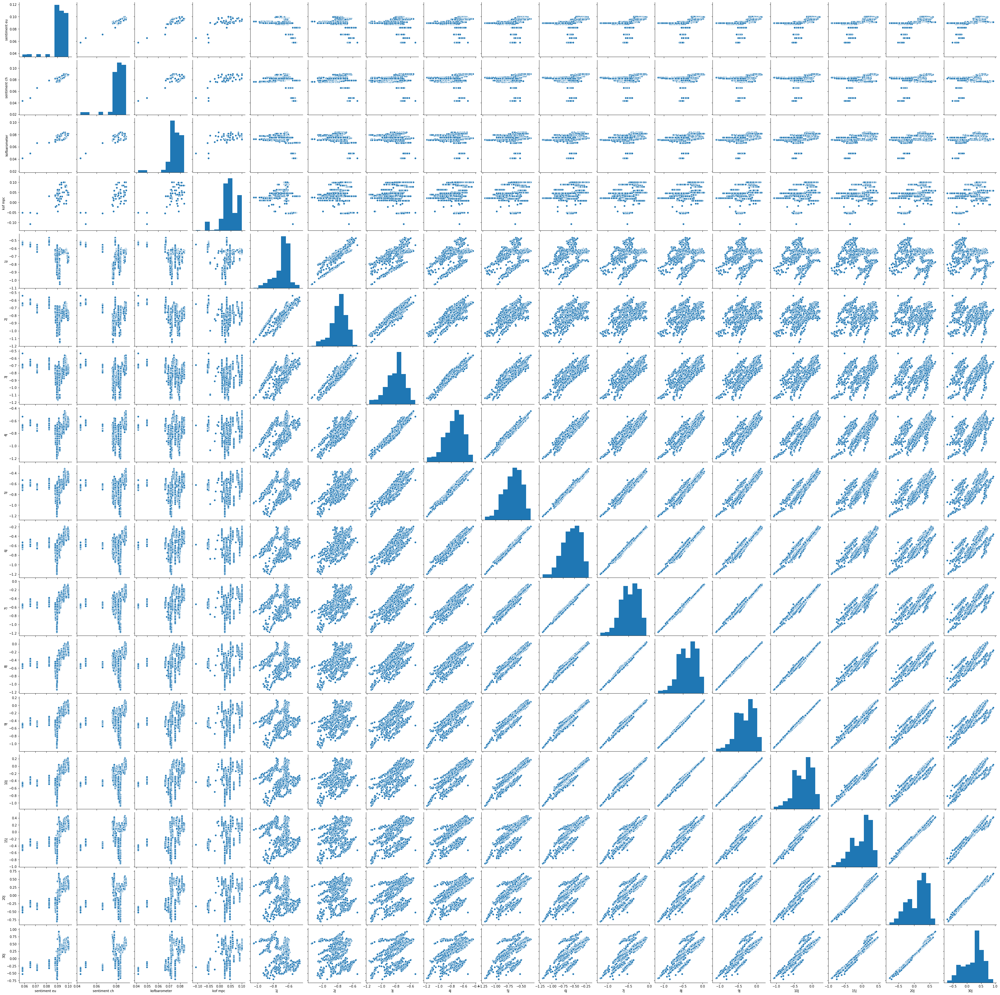

In [228]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_max(df2,21))

<Figure size 864x720 with 0 Axes>

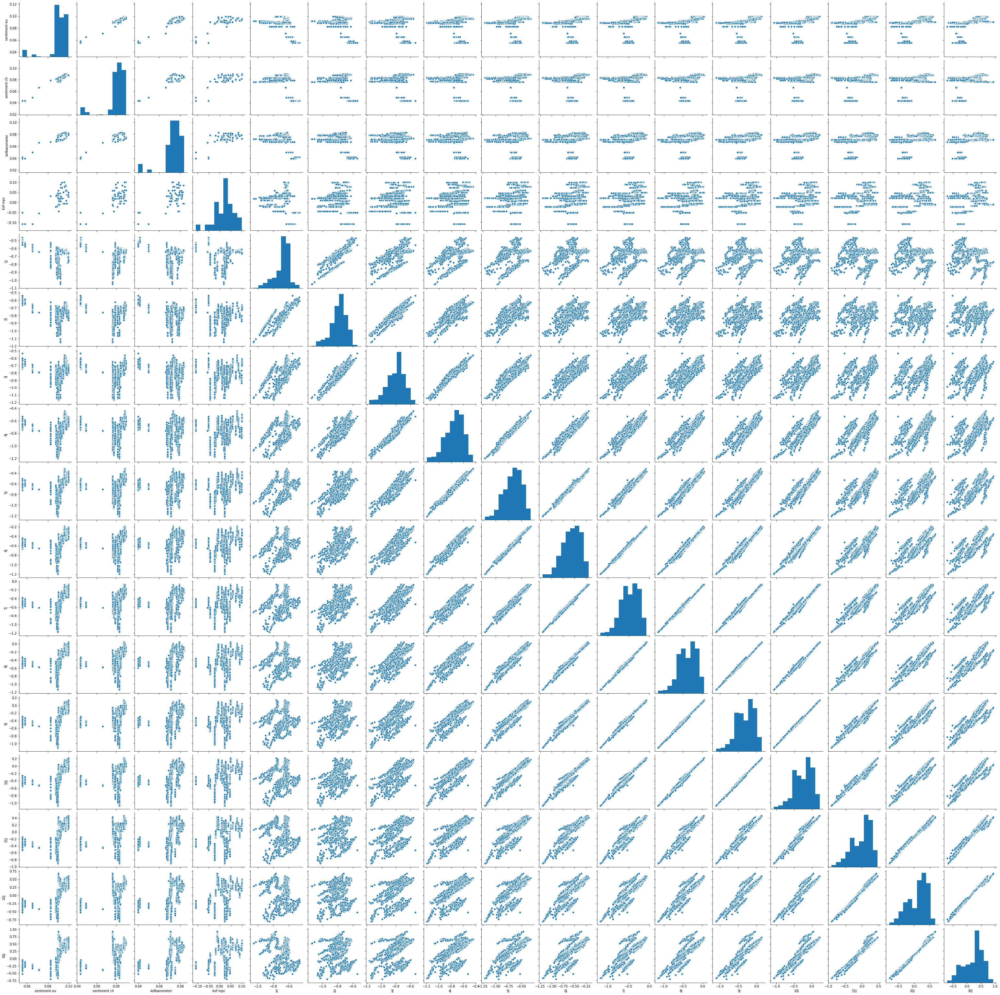

In [229]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_min(df2,21))

In [ ]:
# eco indicators normalized by max / and eco indicateur diff monthly 21 days / try to see curvature / slope coefs

In [241]:
# !pip install nelson_siegel_svensson

In [253]:
from nelson_siegel_svensson.calibrate import calibrate_ns_ols

In [257]:
t =  np.array([1.0, 2.0, 3.0, 4.0, 5.0, 6.0,7.0, 8.0, 9.0, 10.0, 15.0, 20.0,30.0])

In [292]:
y = df.iloc[0,4:].values

In [293]:
curve, status = calibrate_ns_ols(t, y, tau0 = 1.0)  # starting value of 1.0 for the optimization of tau

In [295]:
curve

NelsonSiegelCurve(beta0=0.02898968069649743, beta1=0.0006655913233630354, beta2=-0.01933916927325137, tau=1.0)

In [308]:
def nelson_para(yields):
    t =  np.array([1.0, 2.0, 3.0, 4.0, 5.0, 6.0,7.0, 8.0, 9.0, 10.0, 15.0, 20.0,30.0])
    curve, status = calibrate_ns_ols(t, yields, tau0 = 1.0)  # starting value of 1.0 for the optimization of tau
    p = np.array([curve.beta0, curve.beta1,curve.beta2, curve.tau])
    return p
    

In [309]:
nelson_df = (df.iloc[:,4:].T).apply(nelson_para).T

In [310]:
nelson_df.columns = ['beta0', 'beta1', 'beta2', 'tau']

In [314]:
 new_df = nelson_df.join(df)

In [317]:
def rolling_diff(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).apply(lambda x: x.iloc[-1] - x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,8:])   
def rolling_vol(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).std().copy()).dropna()
    return df2.join(df.iloc[:,8:])   
    
def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,8:])   


In [323]:
df3 = sub_range( new_df,n)

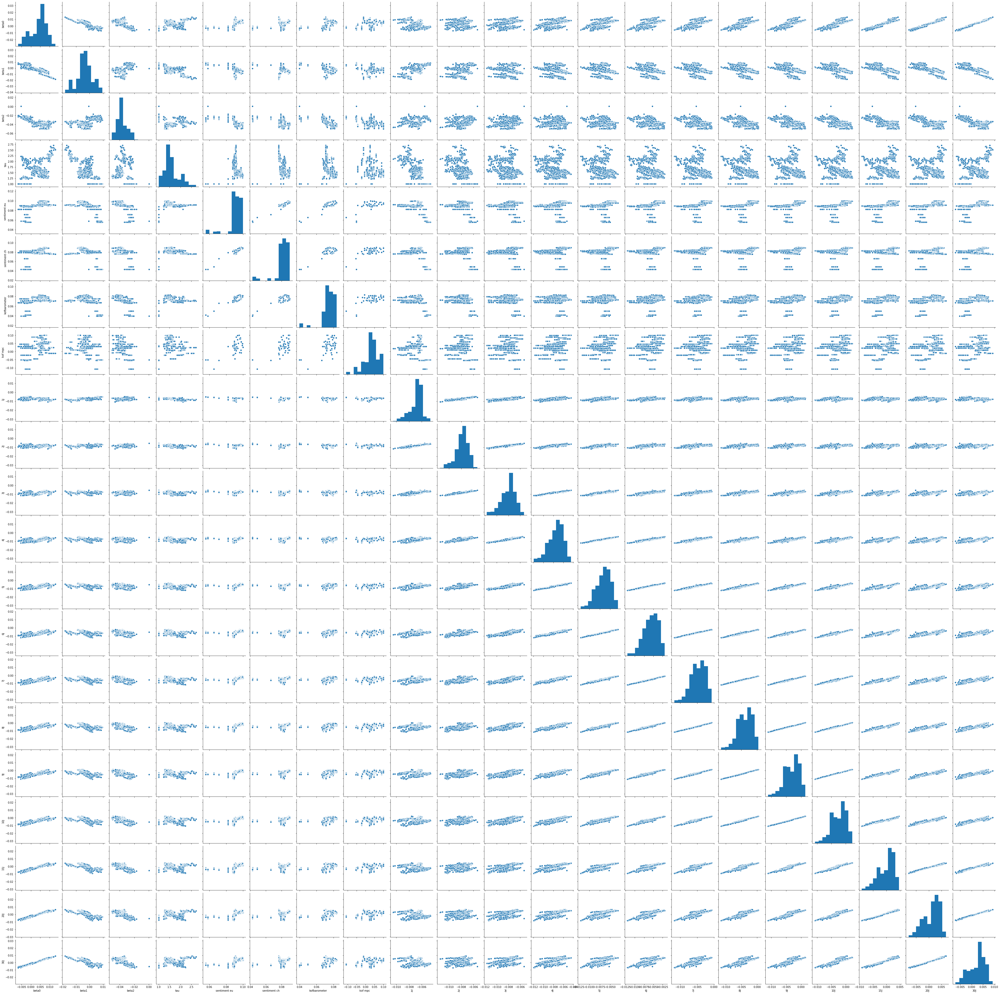

In [325]:
sns.pairplot(df3)

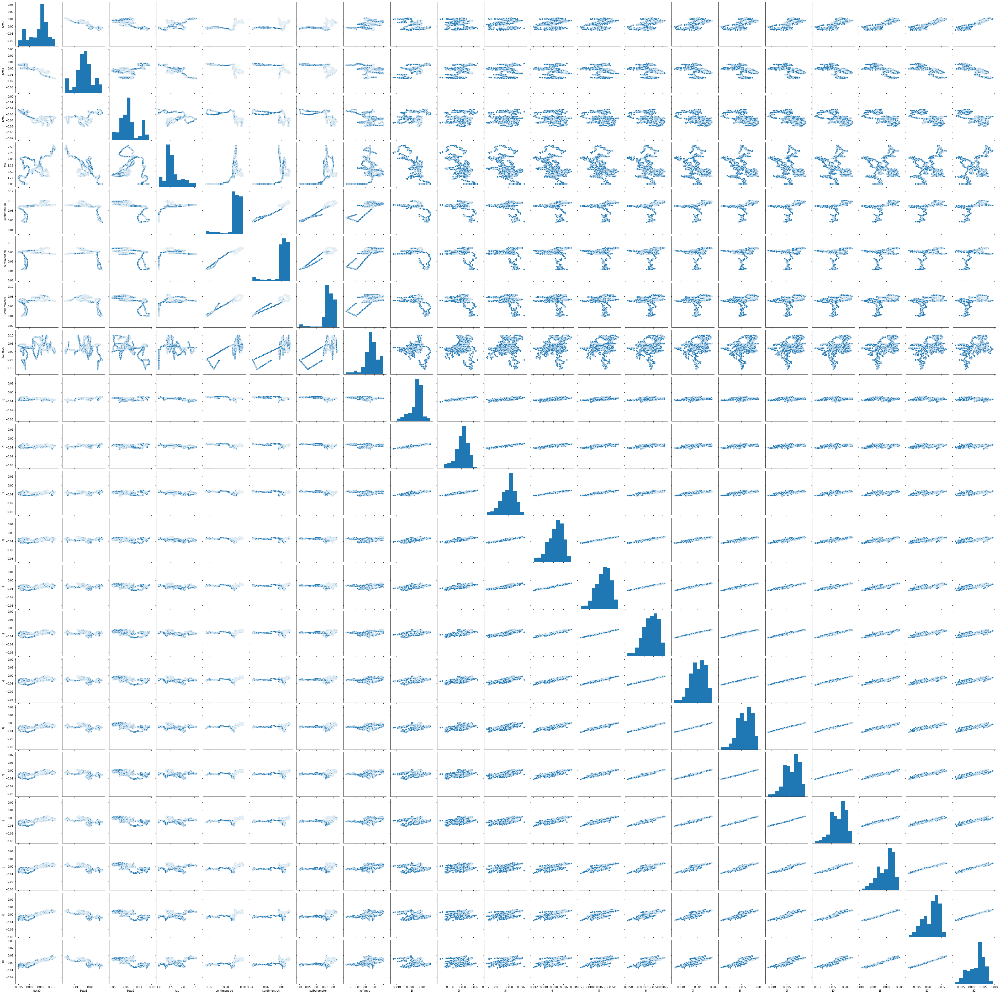

In [326]:
sns.pairplot(rolling_mean(df3,21))

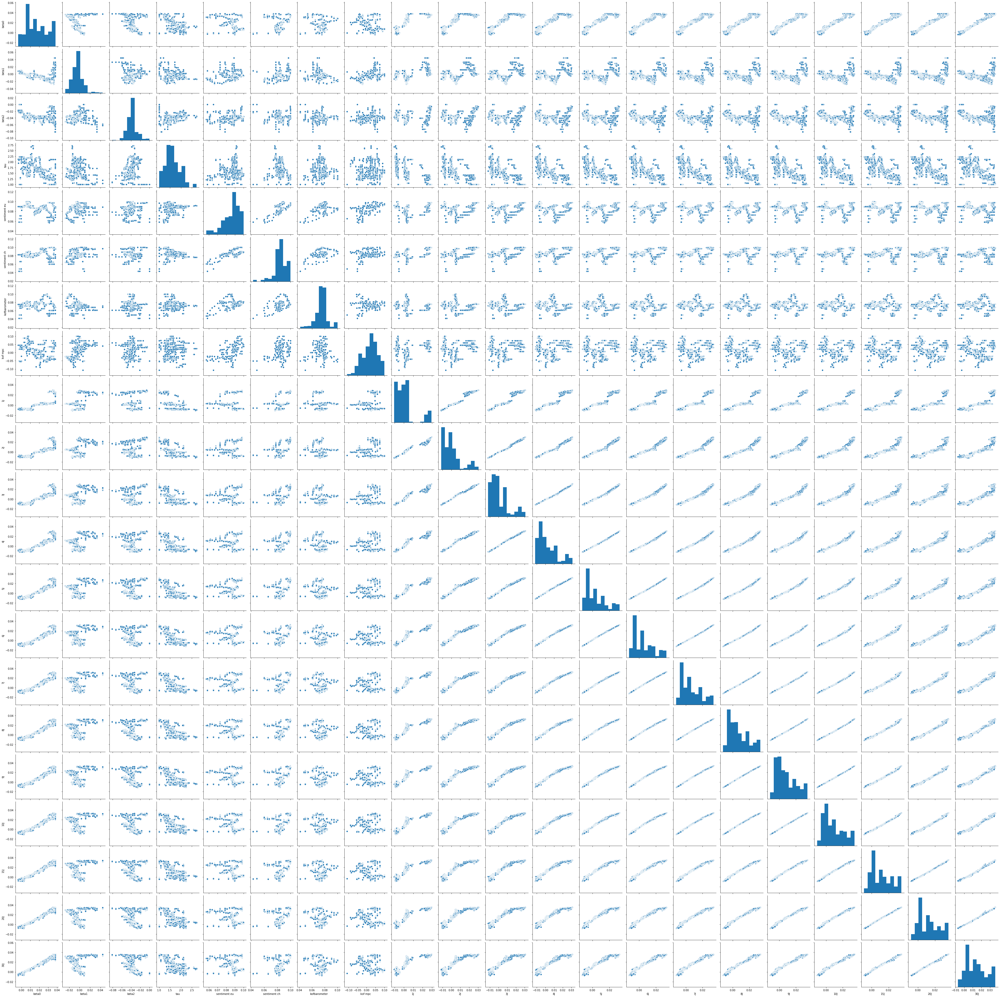

In [327]:
sns.pairplot(rolling_max(new_df,21))